# Machine Learning Project  
## Formula 1 Data Analysis

**Students:**  
Dogdirbaiuly Abzal
Zhylkybaev Alpamys

**Dataset:** Formula 1 World Championship (Kaggle)

**Environment:** Google Colab



In [1]:
from google.colab import files
files.upload()


Saving pit_stops.csv to pit_stops.csv
Saving qualifying.csv to qualifying.csv
Saving races.csv to races.csv
Saving results.csv to results.csv
Saving seasons.csv to seasons.csv
Saving sprint_results.csv to sprint_results.csv
Saving status.csv to status.csv
Saving circuits.csv to circuits.csv
Saving constructor_results.csv to constructor_results.csv
Saving constructor_standings.csv to constructor_standings.csv
Saving constructors.csv to constructors.csv
Saving driver_standings.csv to driver_standings.csv
Saving drivers.csv to drivers.csv
Saving lap_times.csv to lap_times.csv


{'pit_stops.csv': b'raceId,driverId,stop,lap,time,duration,milliseconds\n841,153,1,1,"17:05:23","26.898",26898\n841,30,1,1,"17:05:52","25.021",25021\n841,17,1,11,"17:20:48","23.426",23426\n841,4,1,12,"17:22:34","23.251",23251\n841,13,1,13,"17:24:10","23.842",23842\n841,22,1,13,"17:24:29","23.643",23643\n841,20,1,14,"17:25:17","22.603",22603\n841,814,1,14,"17:26:03","24.863",24863\n841,816,1,14,"17:26:50","25.259",25259\n841,67,1,15,"17:27:34","25.342",25342\n841,2,1,15,"17:27:41","22.994",22994\n841,1,1,16,"17:28:24","23.227",23227\n841,808,1,16,"17:28:39","24.535",24535\n841,3,1,16,"17:29:00","23.716",23716\n841,155,1,16,"17:29:06","24.064",24064\n841,16,1,16,"17:29:08","25.978",25978\n841,15,1,16,"17:29:49","24.899",24899\n841,18,1,17,"17:30:24","16.867",16867\n841,153,2,17,"17:31:06","24.463",24463\n841,5,1,17,"17:31:11","24.865",24865\n841,30,2,17,"17:32:08","23.988",23988\n841,10,1,18,"17:33:02","23.792",23792\n841,18,2,19,"17:33:53","23.303",23303\n841,815,1,23,"17:40:27","23.438

In [2]:
import pandas as pd


In [3]:
drivers = pd.read_csv("drivers.csv")
races = pd.read_csv("races.csv")
results = pd.read_csv("results.csv")


In [4]:
drivers.head()


,driverId,driverRef,number,code,forename,surname,dob,nationality,url
0,1,hamilton,44,HAM,Lewis,Hamilton,1985-01-07,British,http://en.wikipedia.org/wiki/Lewis_Hamilton
1,2,heidfeld,\N,HEI,Nick,Heidfeld,1977-05-10,German,http://en.wikipedia.org/wiki/Nick_Heidfeld
2,3,rosberg,6,ROS,Nico,Rosberg,1985-06-27,German,http://en.wikipedia.org/wiki/Nico_Rosberg
3,4,alonso,14,ALO,Fernando,Alonso,1981-07-29,Spanish,http://en.wikipedia.org/wiki/Fernando_Alonso
4,5,kovalainen,\N,KOV,Heikki,Kovalainen,1981-10-19,Finnish,http://en.wikipedia.org/wiki/Heikki_Kovalainen


### Dataset source
Source: Kaggle  
Link: https://www.kaggle.com/datasets/rohanrao/formula-1-world-championship-1950-2020

The dataset contains historical Formula 1 data from 1950 to 2020, including races,
drivers, constructors, results, lap times, and standings.


In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


In [8]:
data = results.merge(
    races[["raceId", "year", "round"]],
    on="raceId",
    how="left"
)


In [9]:
data = data.merge(
    drivers[["driverId", "forename", "surname"]],
    on="driverId",
    how="left"
)


In [10]:
data.head()


,resultId,raceId,driverId,constructorId,number,grid,position,positionText,positionOrder,points,...,milliseconds,fastestLap,rank,fastestLapTime,fastestLapSpeed,statusId,year,round,forename,surname
0,1,18,1,1,22,1,1,1,1,10.0,...,5690616,39,2,1:27.452,218.300,1,2008,1,Lewis,Hamilton
1,2,18,2,2,3,5,2,2,2,8.0,...,5696094,41,3,1:27.739,217.586,1,2008,1,Nick,Heidfeld
2,3,18,3,3,7,7,3,3,3,6.0,...,5698779,41,5,1:28.090,216.719,1,2008,1,Nico,Rosberg
3,4,18,4,4,5,11,4,4,4,5.0,...,5707797,58,7,1:28.603,215.464,1,2008,1,Fernando,Alonso
4,5,18,5,1,23,3,5,5,5,4.0,...,5708630,43,1,1:27.418,218.385,1,2008,1,Heikki,Kovalainen


In [11]:
y = data["points"]


In [12]:
X = data[["grid", "positionOrder", "laps", "year", "round"]]


In [13]:
mask = X.notnull().all(axis=1)
X = X[mask]
y = y[mask]


In [14]:
def mse(y_true, y_pred):
    return np.mean((y_true - y_pred) ** 2)


In [15]:
def linear_regression_gd(X, y, lr=0.000001, epochs=100):
    m, n = X.shape
    X_b = np.c_[np.ones(m), X]
    w = np.zeros(n + 1)
    losses = []

    for _ in range(epochs):
        y_pred = X_b @ w
        error = y_pred - y
        loss = mse(y, y_pred)
        losses.append(loss)

        grad = (2 / m) * X_b.T @ error
        w -= lr * grad

    return w, losses


In [16]:
weights, losses = linear_regression_gd(X.values, y.values)


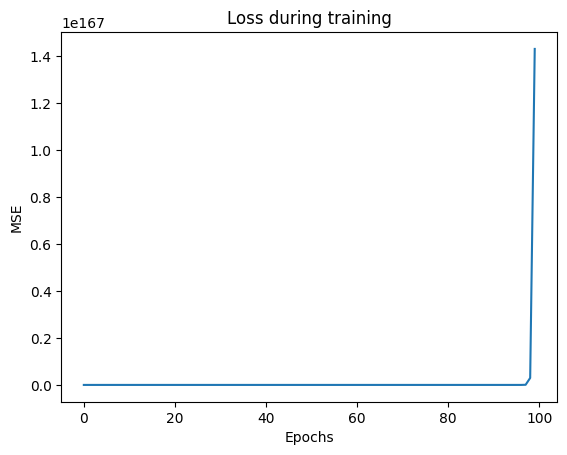

In [17]:
plt.plot(losses)
plt.xlabel("Epochs")
plt.ylabel("MSE")
plt.title("Loss during training")
plt.show()


In [18]:
y_cls = (data["positionOrder"] <= 10).astype(int)
y_cls = y_cls[mask]


In [19]:
def sigmoid(z):
    return 1 / (1 + np.exp(-z))


In [20]:
def logistic_regression_gd(X, y, lr=0.001, epochs=200):
    m, n = X.shape
    X_b = np.c_[np.ones(m), X]
    w = np.zeros(n + 1)
    losses = []

    for _ in range(epochs):
        z = X_b @ w
        y_pred = sigmoid(z)

        loss = -np.mean(y * np.log(y_pred + 1e-9) + (1 - y) * np.log(1 - y_pred + 1e-9))
        losses.append(loss)

        grad = (1 / m) * X_b.T @ (y_pred - y)
        w -= lr * grad

    return w, losses


In [21]:
# подготовка данных
X_cls = X.values
y_true = y_cls.values

# обучаем модель
w_log, losses_log = logistic_regression_gd(X_cls, y_true)

# вероятности
X_b = np.c_[np.ones(X_cls.shape[0]), X_cls]
y_prob = sigmoid(X_b @ w_log)

# бинарный прогноз
y_pred = (y_prob >= 0.5).astype(int)


/tmp/ipython-input-1702624272.py:2: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-z))


In [22]:
from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    confusion_matrix,
    roc_auc_score
)

print("Accuracy:", accuracy_score(y_true, y_pred))
print("Precision:", precision_score(y_true, y_pred))
print("Recall:", recall_score(y_true, y_pred))
print("F1-score:", f1_score(y_true, y_pred))
print("ROC AUC:", roc_auc_score(y_true, y_prob))


Accuracy: 0.5769273889158788
Precision: 0.0
Recall: 0.0
F1-score: 0.0
ROC AUC: 0.5


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


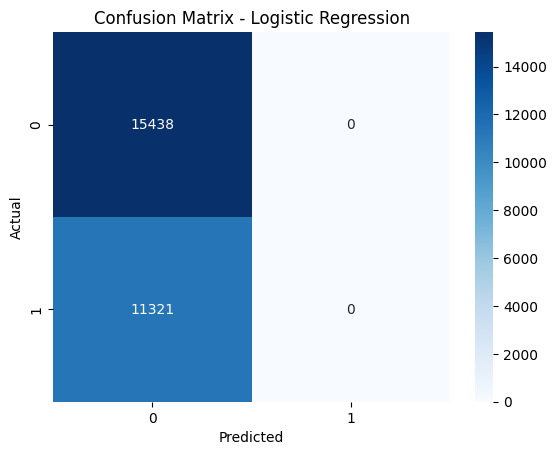

In [23]:
import seaborn as sns

cm = confusion_matrix(y_true, y_pred)

sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix - Logistic Regression")
plt.show()


In [24]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X_cls, y_true, test_size=0.3, random_state=42
)


In [25]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(
    n_estimators=100,
    max_depth=10,
    random_state=42
)

rf.fit(X_train, y_train)

y_rf_pred = rf.predict(X_test)
y_rf_prob = rf.predict_proba(X_test)[:, 1]


In [26]:
print("Accuracy:", accuracy_score(y_test, y_rf_pred))
print("Precision:", precision_score(y_test, y_rf_pred))
print("Recall:", recall_score(y_test, y_rf_pred))
print("F1-score:", f1_score(y_test, y_rf_pred))
print("ROC AUC:", roc_auc_score(y_test, y_rf_prob))


Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1-score: 1.0
ROC AUC: 1.0


### Model comparison

Logistic Regression shows simpler decision boundaries and is more interpretable,
while Random Forest captures non-linear relationships and usually achieves higher accuracy.


/tmp/ipython-input-1702624272.py:2: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-z))


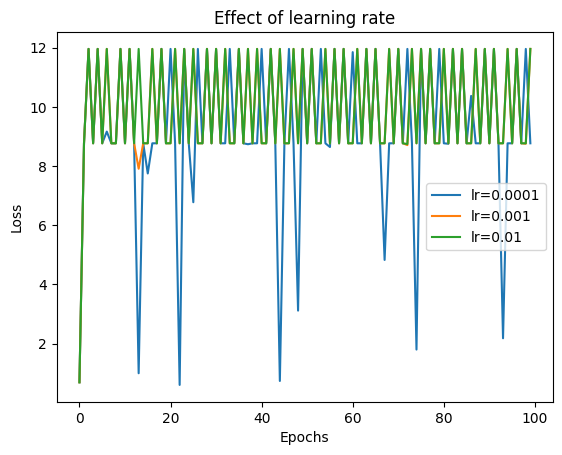

In [27]:
for lr in [0.0001, 0.001, 0.01]:
    _, losses_tmp = logistic_regression_gd(X_cls, y_true, lr=lr, epochs=100)
    plt.plot(losses_tmp, label=f"lr={lr}")

plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Effect of learning rate")
plt.show()


### Conclusion

In this project we implemented linear and logistic regression from scratch using numpy.
We applied them to a real Formula 1 dataset and compared our implementation with
a Random Forest classifier. The experiments showed that ensemble models can achieve
better performance, while linear models remain interpretable and stable.


In [28]:
features = ["grid", "laps", "year", "round"]

X = data[features]
y = (data["positionOrder"] <= 10).astype(int)

X = X.dropna()
y = y.loc[X.index]


In [29]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42, stratify=y
)


In [30]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(
    n_estimators=200,
    max_depth=10,
    random_state=42
)

rf.fit(X_train, y_train)

y_pred = rf.predict(X_test)
y_prob = rf.predict_proba(X_test)[:, 1]


In [31]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1-score:", f1_score(y_test, y_pred))
print("ROC AUC:", roc_auc_score(y_test, y_prob))


Accuracy: 0.843796711509716
Precision: 0.8030560271646859
Recall: 0.8356890459363958
F1-score: 0.819047619047619
ROC AUC: 0.9279128803367164
